In [ ]:
#Download data
import urllib.request, json
import sys
import os

savePath="../data/xeno-canto-dataset-full-all-Countries/"

In [ ]:
def save_json(searchTerms, birdName, country):
    numPages = 1
    page = 1
    # create a path to save json files and recordings
    path = bPath + birdName.replace(':', '') + "/" + country
    if not os.path.exists(path):
        print("Creating subdirectory " + path + " for downloaded files...")
        os.makedirs(path)
        # download a json file for every page found in a query
    while page < numPages + 1:
        print("Loading page " + str(page) + "...")
        url = 'https://www.xeno-canto.org/api/2/recordings?query={0}&page={1}'.format(searchTerms.replace(' ', '%20'),
                                                                                      page)
        print(url)
        jsonPage = urllib.request.urlopen(url)
        jsondata = json.loads(jsonPage.read().decode('utf-8'))
        filename = path + "/jsondata_p" + str(page) + ".json"
        with open(filename, 'w') as outfile:
            json.dump(jsondata, outfile)
        # check number of pages
        numPages = jsondata['numPages']
        page = page + 1
    print("Found ", numPages, " pages in total.")
    # return number of files in json
    # each page contains 500 results, the last page can have less than 500 records
    print("Saved json for ", (numPages - 1) * 500 + len(jsondata['recordings']), " files")
    return path


# reads the json and return the list of values for selected json part
# i.e. "id" - ID number, "type": type of the bird sound such as call or song
# for all Xeno Canto files found with the given search terms.
def read_data(searchTerm, path):
    data = []
    numPages = 1
    page = 1
    # read all pages and save results in a list
    while page < numPages + 1:
        # read file
        with open(path + "/jsondata_p" + str(page) + ".json", 'r') as jsonfile:
            jsondata = jsonfile.read()
        jsondata = json.loads(jsondata)
        # check number of pages
        numPages = jsondata['numPages']
        # find "recordings" in a json and save a list with a search term
        for k in range(len(jsondata['recordings'])):
            data.append(jsondata["recordings"][k][searchTerm])
        page = page + 1
    return data


# downloads all sound files found with the search terms into xeno-canto directory
# into catalogue named after the search term (i.e. Apus apus)
# filename have two parts: the name of the bird in latin and ID number
def download(searchTerms, birdName, country):
    # create data/xeno-canto-dataset directory
    path = save_json(searchTerms, birdName, country)
    # get filenames: recording ID and bird name in latin from json
    filenamesID = read_data('id', path)
    filenamesCountry = read_data('cnt', path)
    # get website recording http download address from json
    fileaddress = read_data('file', path)
    numfiles = len(filenamesID)
    print("A total of ", numfiles, " files will be downloaded")
    for i in range(0, numfiles):
        print("Saving file ", i + 1, "/", numfiles,
              basePath + birdName.replace(':', '') + filenamesID[
                  i] + ".mp3")
        urllib.request.urlretrieve("http:" + fileaddress[i],
                                   path + "/" + birdName + filenamesID[i] + ".mp3")


In [ ]:
countries = ['Poland', 'Germany', 'Slovakia', 'Czech', 'Lithuania']
birds = ['Dendrocopos major',
         'Chloris chloris',
         'Corvus frugilegus',
         'Coccothraustes coccothraustes',
         'Columba palumbus',
         'Delichon urbicum',
         'Apus apus',
         'Sitta europaea',
         'Corvus monedula',
         'Phoenicurus ochruros',
         'Turdus merula',
         'Turdus pilaris',
         'Passer montanus',
         'Phylloscopus trochilus',
         'Phylloscopus collybita',
         'Phoenicurus phoenicurus',
         'Motacilla alba',
         'Erithacus rubecula',
         'Streptopelia decaocto',
         'Parus major',
         'Parus caeruleus',
         'Alauda arvensis',
         'Luscinia luscinia',
         'Garrulus glandarius',
         'Turdus philomelos',
         'Pica pica',
         'Troglodytes troglodytes',
         'Carduelis carduelis',
         'Sturnus vulgaris',
         'Emberiza citrinella',
         'Passer domesticus',
         'Corvus corone',
         'Fringilla coelebs']

for country in countries:
    for bird in birds:
        download(bird + ' cnt:' + country + ' type:song', bird.replace(' ', ''), country)
for bird in birds:
    download(bird + ' type:song', bird.replace(' ', ''), 'countries')

In [ ]:
#Sample recordings

In [ ]:

import json
#from AM_downloadDataset import read_data

In [ ]:
def read_data(searchTerm, path):
    data = []
    numPages = 1
    page = 1
    # read all pages and save results in a list
    while page < numPages + 1:
        # read file
        with open(path + "/jsondata_p" + str(page) + ".json", 'r') as jsonfile:
            jsondata = jsonfile.read()
        jsondata = json.loads(jsondata)
        # check number of pages
        numPages = jsondata['numPages']
        # find "recordings" in a json and save a list with a search term
        for k in range(len(jsondata['recordings'])):
            data.append(jsondata["recordings"][k][searchTerm])
        page = page + 1
    return data


In [ ]:
countries = ['Poland', 'Germany', 'Slovakia', 'Czech', 'Lithuania']

# initialize dictionary of a bird
bird = {
        'gen':'Emberiza',
        'spec':'citrinella',
        'country':countries,
        'number of files': 
            {
            'total' : 0,
            'quality':{'A':0,
                        'B':0,
                        'C':0,
                        'D':0,
                        'E':0,
                        'F':0,
                      }
            },
        'length':{'min':0,
                      'max':0,
                      'mean':0,
                      'median':0
                      }
        }

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
pip install mutagen

     |████████████████████████████████| 215kB 2.8MB/s 


In [ ]:

from mutagen.mp3 import MP3
from statistics import mean, median
import os

audioLengths = list()
audioLengthTemp = []
for country in countries:
        # find the driectory with recordings
        path = '/content/gdrive/My Drive/data/' + bird['gen'] +bird['spec']+ '/'+country
        print('Loading data from folder ' + path)
        
        # load info about the quality of the recording from json file
        qualityData = read_data('q', path)
        bird['number of files']['total']=bird['number of files']['total']+len(qualityData)
        for quality in bird['number of files']['quality']:
             bird['number of files']['quality'][quality]=bird['number of files']['quality'][quality]+qualityData.count(quality)
        
        # load MP3 file of every recording and check the length of a file
        idData = read_data('id', path)
        dataCounter=0
        for audioFile in range(len(idData)):
            if os.path.exists(path+'/'+bird['gen']+bird['spec']+idData[audioFile]+'.mp3'):
                audioLengthTemp.append(MP3(path+'/'+bird['gen']+bird['spec']+idData[audioFile]+'.mp3').info.length)
                dataCounter=dataCounter+1
                        
        audioLengths = list(audioLengthTemp) + list(audioLengths)
        print("Loaded ", dataCounter," out of ",len(idData)," files")

bird['length']['max']=max(audioLengths)
bird['length']['min']=min(audioLengths)
bird['length']['mean']=mean(audioLengths) 
bird['length']['median']=median(audioLengths)

Loading data from folder /content/gdrive/My Drive/data/Emberizacitrinella/Poland
Loaded  176  out of  176  files
Loading data from folder /content/gdrive/My Drive/data/Emberizacitrinella/Germany
Loaded  69  out of  142  files
Loading data from folder /content/gdrive/My Drive/data/Emberizacitrinella/Slovakia
Loaded  2  out of  2  files
Loading data from folder /content/gdrive/My Drive/data/Emberizacitrinella/Czech
Loaded  16  out of  16  files
Loading data from folder /content/gdrive/My Drive/data/Emberizacitrinella/Lithuania
Loaded  7  out of  7  files


In [ ]:
ls /content/gdrive/My\ Drive/data/Emberizacitrinella/Poland/jsondata_p1.json

'/content/gdrive/My Drive/data/Emberizacitrinella/Poland/jsondata_p1.json'


In [ ]:
from random import sample

# find the driectory with recordings
path = '/content/gdrive/My Drive/data/' +bird['gen']+bird['spec']+'/'+'Poland'
print('Loading data from folder ' + path)

# load json file:  read all id numbers
idData = read_data('id', path)
qualityData = read_data('q',path)

# select random 5 recordings from Poland
randFiles = sample(range(len(idData)), 3)
print('Selected random files number:',randFiles)

Loading data from folder /content/gdrive/My Drive/data/Emberizacitrinella/Poland
Selected random files number: [103, 166, 144]


In [ ]:

import IPython.display as ipd


for audioFile in randFiles:
    # path of random file
    filePath = path+'/'+bird['gen']+bird['spec']+idData[audioFile]+'.mp3'
    print('Play the file number '+ str(audioFile)+', quality: '+ qualityData[audioFile])
    # show the recording and allow to play it
    ipd.display(ipd.Audio(filePath))

Play the file number 103, quality: B


Play the file number 166, quality: C


Play the file number 144, quality: B


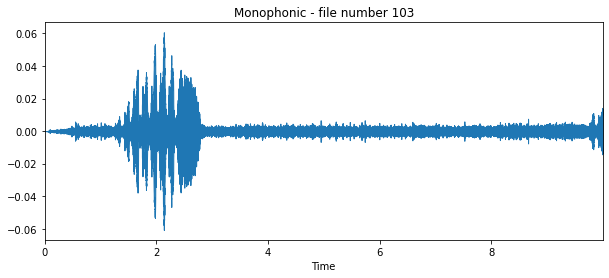

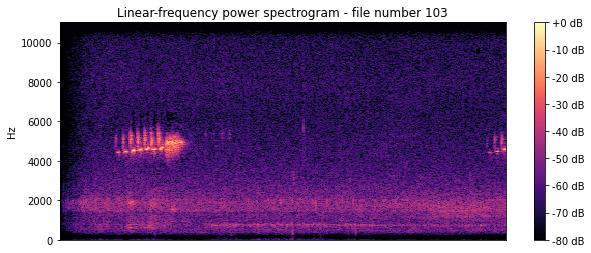

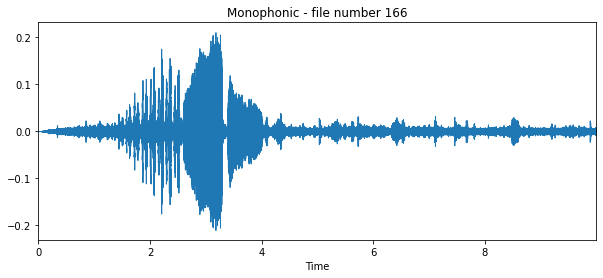

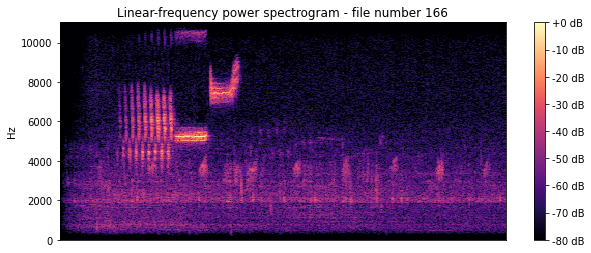

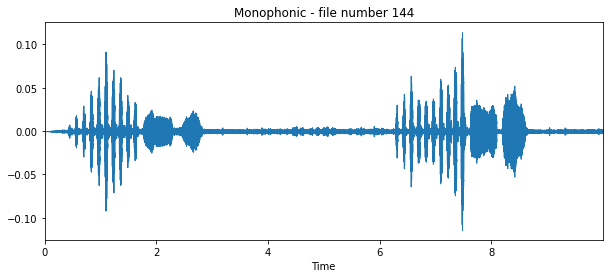

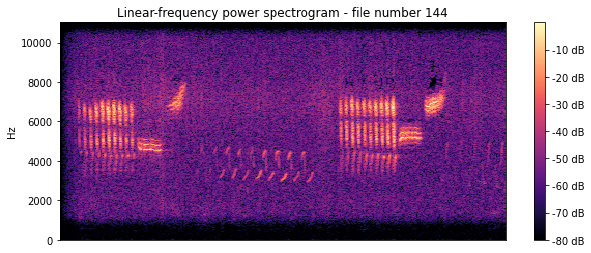

In [ ]:

import matplotlib.pyplot as plt
import librosa
import librosa.display
import numpy as np


for audioFile in randFiles:
    # path of random file
    filePath = path+'/'+bird['gen']+bird['spec']+idData[audioFile]+'.mp3'

    # plot recording signal
    y, sr = librosa.load(filePath,duration=10)
    plt.figure(figsize=(10, 4))
    librosa.display.waveplot(y, sr=sr)
    plt.title('Monophonic - file number '+str(audioFile))
    plt.show()
    
    # plot spectogram
    plt.figure(figsize=(10, 4))
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    librosa.display.specshow(D, y_axis='linear')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Linear-frequency power spectrogram - file number '+str(audioFile))
    plt.show()

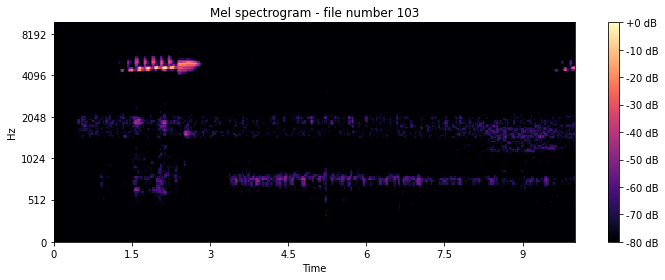

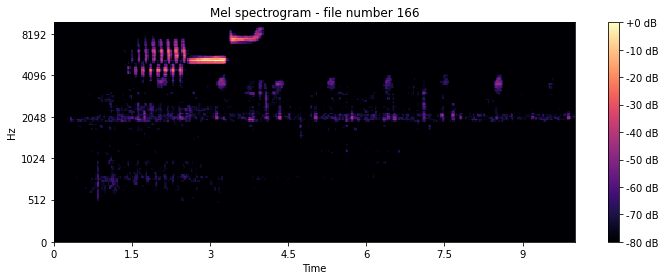

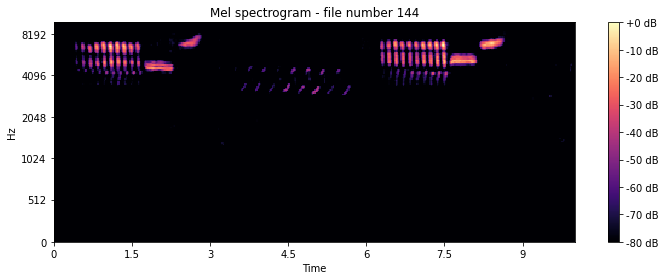

In [ ]:
for audioFile in randFiles:
    # path of random file
    filePath = path+'/'+bird['gen']+bird['spec']+idData[audioFile]+'.mp3'

    # loading files again
    y, sr = librosa.load(filePath,duration=10)

    # plot mel-spectogram
    # Passing through arguments to the Mel filters
    S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,fmax=10000)
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(librosa.power_to_db(S**2,ref=np.max),
                          y_axis='mel', fmax=10000,x_axis='time')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Mel spectrogram - file number '+str(audioFile))
    plt.tight_layout()
    plt.show()


In [ ]:
#noise reduction

In [ ]:
pip install noisereduce

  Created wheel for noisereduce: filename=noisereduce-1.1.0-cp36-none-any.whl size=7608 sha256=032d3117202909a0ebbbf0a88c6f9e9e08b4cea1d2b03a897a52d371ae285dfb
  Stored in directory: /root/.cache/pip/wheels/a6/2c/70/f9ccb41280dcfbe3eaeb7930f913dd85394617f3d3136f29cc
Successfully built noisereduce


Before denoising: File number 103, quality: B


/usr/local/lib/python3.6/dist-packages/noisereduce/noisereduce.py:5: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


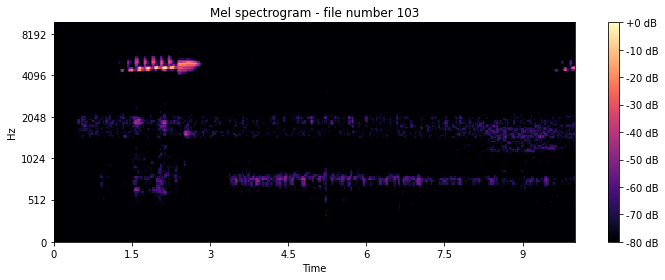

After denoising


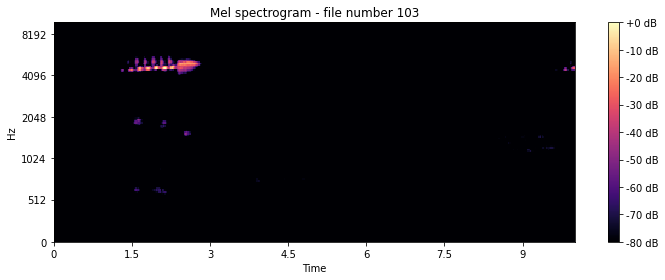

Before denoising: File number 166, quality: C


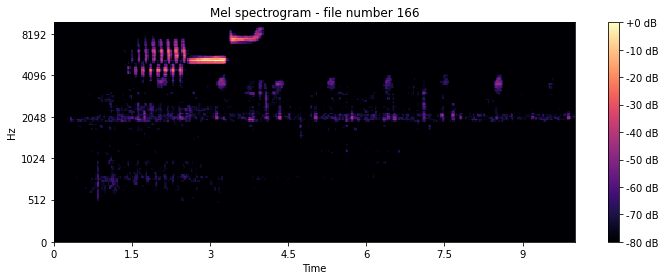

After denoising


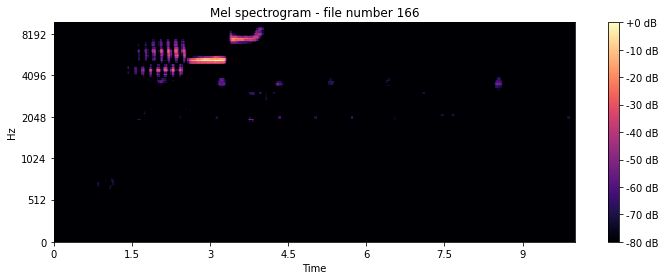

Before denoising: File number 144, quality: B


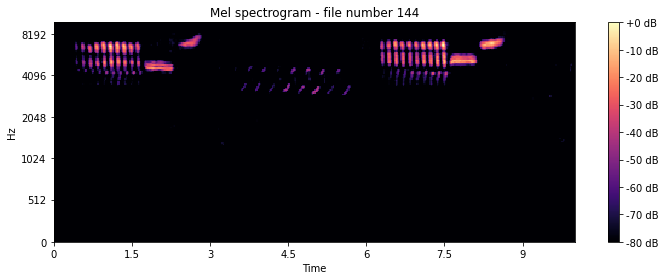

After denoising


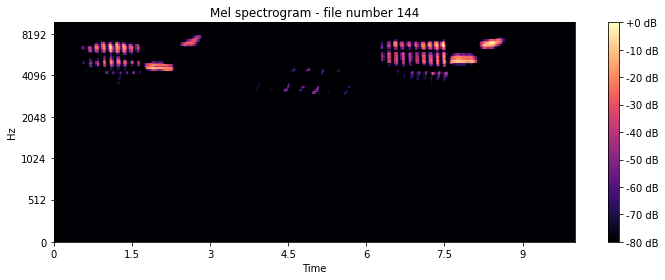

In [ ]:
import noisereduce as nr
for audioFile in randFiles:
    # path of random file
    filePath = path+'/'+bird['gen']+bird['spec']+idData[audioFile]+'.mp3'
    print('Before denoising: File number '+ str(audioFile)+', quality: '+ qualityData[audioFile])
    # show the recording and allow to play it
    ipd.display(ipd.Audio(filePath))
    
    # load a file again
    data, r = librosa.load(filePath,duration=10)
    
    # plot mel-spectogram before denosing
    S = librosa.feature.melspectrogram(y=data, sr=sr, n_mels=128,fmax=10000)
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(librosa.power_to_db(S**2,ref=np.max),
                          y_axis='mel', fmax=10000,x_axis='time')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Mel spectrogram - file number '+str(audioFile))
    plt.tight_layout()
    plt.show()    
    
    # reduce noise
    reduced_noise = nr.reduce_noise(audio_clip=data, noise_clip=data, prop_decrease = 1, verbose=False)
    
    # plot mel-spectogram after denosing
    print("After denoising")
    ipd.display(ipd.Audio(reduced_noise,rate=r))
    S = librosa.feature.melspectrogram(y=reduced_noise, sr=sr, n_mels=128,fmax=10000)
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(librosa.power_to_db(S**2,ref=np.max),
                          y_axis='mel', fmax=10000,x_axis='time')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Mel spectrogram - file number '+str(audioFile))
    plt.tight_layout()
    plt.show()


****** Emberiza   citrinella ******
Found  519  files in total, from countires:  ['Poland', 'Germany', 'Slovakia', 'Czech', 'Lithuania']
Number of files with quality: A =  185 , B =  241 , C =  61 , D =  26 , E =  2
Shortest file:  2.4760625  seconds
Longest file:  1863.2665714285715  seconds
Average length:  111.90781715501632 s,  
median length:  69.54775 s


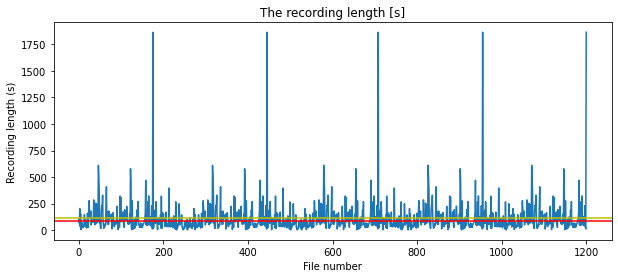

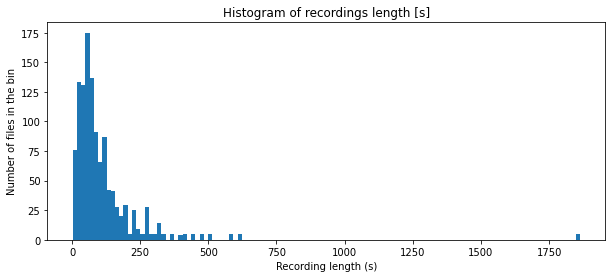

In [ ]:
print('******',bird["gen"],' ',bird['spec'],'******',)
print("Found ", bird['number of files']['total']," files in total, from countires: ", bird['country'])
print("Number of files with quality: A = ", bird['number of files']['quality']['A'],
          ", B = ", bird['number of files']['quality']['B'],
         ", C = ", bird['number of files']['quality']['C'],
         ", D = ", bird['number of files']['quality']['D'],
         ", E = ", bird['number of files']['quality']['E'])
print("Shortest file: ", bird['length']['min'], ' seconds')
print("Longest file: ", bird['length']['max'], ' seconds')
print("Average length: ", bird['length']['mean'], 's, ',"\nmedian length: ", bird['length']['median'], 's' )

# Plot a length of recordings with the line of a median and average length
plt.figure(figsize=(10, 4))
plt.title('The recording length [s]')
plt.ylabel('Recording length (s)')
plt.xlabel('File number')
plt.plot(audioLengths)
plt.axhline(y=bird['length']['median']+20, color='r', linestyle='-') # plot the line at a median
plt.axhline(y=bird['length']['mean'], color='y', linestyle='-') # plot the line at a mean

# Plot histogram
plt.figure(figsize=(10, 4))
plt.title('Histogram of recordings length [s]')
plt.xlabel('Recording length (s)')
plt.ylabel('Number of files in the bin')
plt.hist(audioLengths, bins  = 'fd')
plt.show()

In [ ]:
#mel spectrogram

view data

In [ ]:
import os


birds=[] # list of all birds (Ember, Phyll...)
blist=[] # list of files for one bird
flist=[] # list of all files for all birds. A list of blists. 
for root, dirs, files in os.walk("/content/gdrive/My\ Drive/data/"):
    if root == "/content/gdrive/My\ Drive/data/":
        birds=dirs        

for bird in birds:
    for root, dirs, files in os.walk("/content/gdrive/My\ Drive/data/"+bird):
        for file in files:
            if file.endswith(".png"):
                blist.append(os.path.join(root, file))
    print("Found ", len(blist), ' files for ', bird)
    flist.append(blist)
    blist=[]

In [ ]:
import os

In [ ]:
melsPath= "/content/gdrive/My\ Drive/birdmel/"

In [ ]:
Prepare data

In [ ]:
%matplotlib inline
import matplotlib
matplotlib.interactive(False)
matplotlib.use('Agg')

%matplotlib inline
import matplotlib
matplotlib.interactive(False)
matplotlib.use('Agg')

# find all of the files in the directory
import os
import gc
basePath="/content/gdrive/My\ Drive/data/"
melsPath= "/content/gdrive/My\ Drive/birdmel/"

birds=[] # list of all birds
for root, dirs, files in os.walk(basePath):
    if root == basePath:
        birds=dirs
birds50=[]                
flist=[] # list of all files
blist=[] # list of files for one bird 
i50=0;
for i, bird in enumerate(birds):
    for root, dirs, files in os.walk(basePath+bird):
        for file in files:
          blist.append(os.path.join(root, file))
    if len(blist) > 50:
        i50 = i50+1;
        print(i50, ". Found ", len(blist), ' files for ', bird ,'(',i+1,')')
        birds50.append(bird)
        flist.append(blist)
    blist=[]
print(birds50) 

[]


In [ ]:
import os
import gc
basePath="/content/gdrive/My Drive/data/"
melsPath= "/content/gdrive/My Drive/mel/"

birds=[] # list of all birds
for dirs in os.listdir(basePath):
        birds.append(dirs)
print(birds)

['Corvuscorone', 'Dendrocoposmajor', 'Chlorischloris', 'Corvusfrugilegus', 'Coccothraustescoccothraustes', 'Columbapalumbus', 'Delichonurbicum', 'Apusapus', 'Sittaeuropaea', 'Corvusmonedula', 'Phoenicurusochruros', 'Turdusmerula', 'Turduspilaris', 'Passermontanus', 'Phylloscopustrochilus', 'Phylloscopuscollybita', 'Phoenicurusphoenicurus', 'Motacillaalba', 'Erithacusrubecula', 'Streptopeliadecaocto', 'Parusmajor', 'Paruscaeruleus', 'Alaudaarvensis', 'Luscinialuscinia', 'Garrulusglandarius', 'Turdusphilomelos', 'Picapica', 'Troglodytestroglodytes', 'Cardueliscarduelis', 'Sturnusvulgaris', 'Emberizacitrinella', 'Passerdomesticus', 'Fringillacoelebs']


In [ ]:
birds50=[]                
flist=[] # list of all files
blist=[] # list of files for one bird 
i50=0;
for i, bird in enumerate(birds):
    for root, dirs, files in os.walk(basePath+bird):
        for file in files:
            if file.endswith(".mp3"):
                blist.append(os.path.join(root, file))
    if len(blist) > 50:
        i50 = i50+1;
        print(i50, ". Found ", len(blist), ' files for ', bird ,'(',i+1,')')
        birds50.append(bird)
        flist.append(blist)
    blist=[]
print(birds50) 
print(root)

1 . Found  268  files for  Chlorischloris ( 3 )
2 . Found  146  files for  Coccothraustescoccothraustes ( 5 )
3 . Found  184  files for  Columbapalumbus ( 6 )
4 . Found  63  files for  Delichonurbicum ( 7 )
5 . Found  577  files for  Sittaeuropaea ( 9 )
6 . Found  86  files for  Phoenicurusochruros ( 11 )
7 . Found  127  files for  Turdusmerula ( 12 )
8 . Found  61  files for  Passermontanus ( 14 )
9 . Found  189  files for  Phylloscopustrochilus ( 15 )
10 . Found  358  files for  Phylloscopuscollybita ( 16 )
11 . Found  118  files for  Phoenicurusphoenicurus ( 17 )
12 . Found  283  files for  Erithacusrubecula ( 19 )
13 . Found  175  files for  Parusmajor ( 21 )
14 . Found  110  files for  Luscinialuscinia ( 24 )
15 . Found  55  files for  Garrulusglandarius ( 25 )
16 . Found  609  files for  Turdusphilomelos ( 26 )
17 . Found  67  files for  Picapica ( 27 )
18 . Found  169  files for  Troglodytestroglodytes ( 28 )
19 . Found  57  files for  Cardueliscarduelis ( 29 )
20 . Found  83  f

In [ ]:
def saveMel(signal, directory):
    
    # MK_spectrogram modified
    N_FFT = 1024         # 
    HOP_SIZE = 1024      #  
    N_MELS = 128          # Higher   
    WIN_SIZE = 1024      # 
    WINDOW_TYPE = 'hann' # 
    FEATURE = 'mel'      # 
    FMIN = 1400

    fig = plt.figure(1,frameon=False)
    fig.set_size_inches(6,6)

    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    fig.add_axes(ax)
    
    S = librosa.feature.melspectrogram(y=signal, sr=sr,
                                        n_fft=N_FFT,
                                        hop_length=HOP_SIZE, 
                                        n_mels=N_MELS, 
                                        htk=True, 
                                        fmin=FMIN, # higher limit ##high-pass filter freq.
                                        fmax=sr/2) # AMPLITUDE
    librosa.display.specshow(librosa.power_to_db(S**2,ref=np.max), fmin=FMIN) #power = S**2

    fig.savefig(directory)
    plt.ioff()
    #plt.show(block=False)
    fig.clf()
    ax.cla()
    plt.clf()
    plt.close('all')

In [ ]:
os.mkdir("/content/gdrive/My Drive/mel")

In [ ]:
melsPath= "/content/gdrive/My Drive/mel/"

In [ ]:
import warnings
warnings.filterwarnings('ignore')
import os
import sys
from tqdm import tqdm_notebook as tqdm
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt

size = {'desired': 5, # [seconds]
        'minimum': 4, # [seconds]
        'stride' : 0, # [seconds]
        'name': 5 # [number of letters]
       } # stride should not be bigger than desired length

print('Number of directories to check and cut: ', len(flist))

#step = (size['desired']-size['stride'])*sr # length of step between two cuts in seconds
step=1
if step>0:
    for bird, birdList in enumerate(flist):
        print("Processing ",bird,'. ', birds50[bird], "...")
        for birdnr, path in tqdm(enumerate(birdList)):
            # load the mp3 file
            directory=melsPath+str(bird)+birds50[bird][:size['name']]+"/"

            if not os.path.exists(directory):
                os.makedirs(directory)
                
            if not os.path.exists(directory+path.rsplit('/',1)[1].replace(' ', '')[:-4]+"1_1.png"):
                  
                signal, sr = librosa.load(path) # sr = sampling rate
                step = (size['desired']-size['stride'])*sr # length of step between two cuts in seconds
                
                nr=0;
                for start, end in zip(range(0,len(signal),step),range(size['desired']*sr,len(signal),step)):
                    # cut file and save each piece
                    nr=nr+1
                    # save the file if its length is higher than minimum
                    if end-start > size['minimum']*sr:
                        melpath=path.rsplit('/',1)[1]
                        melpath=directory+melpath.replace(' ', '')[:-4]+str(nr)+"_"+str(nr)+".png"
                        saveMel(signal[start:end],melpath)
                    #print('New file...',start/sr,' - ',end/sr)
                    #print('Start: ',start,'end: ', end, 'length: ', end-start)
                
            pass
else:    
    print("Error: Stride should be lower than desired length.")
    
print('Number of files after cutting: ')


Number of directories to check and cut:  23
Processing  0 .  Chlorischloris ...



Processing  1 .  Coccothraustescoccothraustes ...



Processing  2 .  Columbapalumbus ...



Processing  3 .  Delichonurbicum ...



Processing  4 .  Sittaeuropaea ...



Processing  5 .  Phoenicurusochruros ...



Processing  6 .  Turdusmerula ...



Processing  7 .  Passermontanus ...



Processing  8 .  Phylloscopustrochilus ...



Processing  9 .  Phylloscopuscollybita ...



Processing  10 .  Phoenicurusphoenicurus ...



Processing  11 .  Erithacusrubecula ...



Processing  12 .  Parusmajor ...



Processing  13 .  Luscinialuscinia ...



Processing  14 .  Garrulusglandarius ...



Processing  15 .  Turdusphilomelos ...



Processing  16 .  Picapica ...



Processing  17 .  Troglodytestroglodytes ...



Processing  18 .  Cardueliscarduelis ...



Processing  19 .  Sturnusvulgaris ...



Processing  20 .  Emberizacitrinella ...



Processing  21 .  Passerdomesticus ...



Processing  22 .  Fringillacoelebs ...



Number of files after cutting: 


['0Chlor', '1Cocco', '2Colum', '3Delic', '4Sitta', '5Phoen', '6Turdu', '7Passe', '8Phyll', '9Phyll', '10Phoen', '11Erith', '12Parus', '13Lusci', '14Garru', '15Turdu', '16Picap', '17Trogl', '18Cardu', '19Sturn', '20Ember', '21Passe', '22Fring']
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]


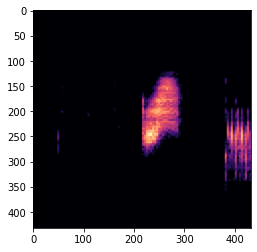

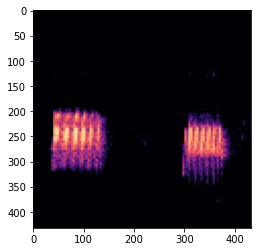

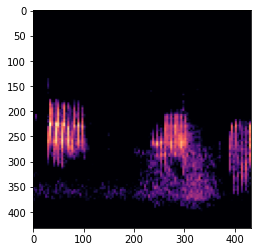

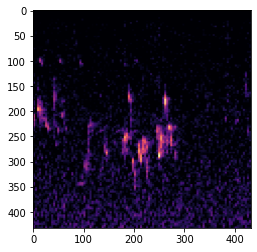

Found  107481  files


In [ ]:
import matplotlib.image as mpimg
ilist=[]
for root, dirs, files in os.walk(melsPath):
    print(dirs)
    for file in files:
        if file.endswith(".png"):
            ilist.append(os.path.join(root, file))
img=mpimg.imread(ilist[0])
imgplot = plt.imshow(img)
plt.show()
img=mpimg.imread(ilist[100])
imgplot = plt.imshow(img)
plt.show()
img=mpimg.imread(ilist[1000])
imgplot = plt.imshow(img)
plt.show()
img=mpimg.imread(ilist[40000])
imgplot = plt.imshow(img)
plt.show()
print("Found ",len(ilist)," files")

#Split Dataset

In [ ]:
import os

# define number of files for all sets
train = 0.8 # 80% of all sound should be in the train set
val = 0.1 # 10% validation set
test = 0.1 # 10% test set
kfolds = 1
basePath="/content/gdrive/My Drive/data/" # path with sound files. Can be downloaded with "AM_downloadData"
imPath = "/content/gdrive/My Drive/mel/" # path with images (melspectrograms)
                                # Can be generated with "AM_prepareData" after downloading sound files
destPath = "/content/gdrive/My Drive/splitdata/" # destination path - where the split dataset should be copied
                            # This folder will be used to train CNNs

# first find all of the mp3 files in the directory
birds=[] # list of all bird spiecies (Ember, Phyll...)
singleBirdList=[] # list of files for one bird
allFilesList=[] # list of all files for all birds. A list of singleBirdLists. 
for root, dirs, files in os.walk(basePath):
    if root == basePath:
        birds=dirs
print(birds)

trainSet=[]
testSet=[]
valSet=[]

birdsShort=[] # list of short file names
birdNumber=0
for nr,bird in enumerate(birds):
    for root, dirs, files in os.walk(basePath+bird):
        for file in files:
            if file.endswith(".mp3"):
                singleBirdList.append(os.path.join(root, file))
    if len(singleBirdList) > 50:
        birdsShort.append(str(birdNumber)+bird[:5])
        birdNumber = birdNumber+1;
        print("Found ", len(singleBirdList), ' mp3 files for ', bird)
        trainSet.append(int(train*len(singleBirdList)))
        valSet.append(int(val*len(singleBirdList)))
        roundDiff = len(singleBirdList)-(int(train*len(singleBirdList))+int(test*len(singleBirdList))+int(val*len(singleBirdList))) 
        testSet.append(int(test*len(singleBirdList)) + roundDiff)
        print("Size of train: ", int(train*len(singleBirdList)),", val: ",int(val*len(singleBirdList)) ,", test: ",int(test*len(singleBirdList)))
        allFilesList.append(singleBirdList)
    singleBirdList=[]


print(trainSet)
print(valSet)
print(testSet)

['Corvuscorone', 'Dendrocoposmajor', 'Chlorischloris', 'Corvusfrugilegus', 'Coccothraustescoccothraustes', 'Columbapalumbus', 'Delichonurbicum', 'Apusapus', 'Sittaeuropaea', 'Corvusmonedula', 'Phoenicurusochruros', 'Turdusmerula', 'Turduspilaris', 'Passermontanus', 'Phylloscopustrochilus', 'Phylloscopuscollybita', 'Phoenicurusphoenicurus', 'Motacillaalba', 'Erithacusrubecula', 'Streptopeliadecaocto', 'Parusmajor', 'Paruscaeruleus', 'Alaudaarvensis', 'Luscinialuscinia', 'Garrulusglandarius', 'Turdusphilomelos', 'Picapica', 'Troglodytestroglodytes', 'Cardueliscarduelis', 'Sturnusvulgaris', 'Emberizacitrinella', 'Passerdomesticus', 'Fringillacoelebs']
Found  268  mp3 files for  Chlorischloris
Size of train:  214 , val:  26 , test:  26
Found  146  mp3 files for  Coccothraustescoccothraustes
Size of train:  116 , val:  14 , test:  14
Found  184  mp3 files for  Columbapalumbus
Size of train:  147 , val:  18 , test:  18
Found  63  mp3 files for  Delichonurbicum
Size of train:  50 , val:  6 , 

In [ ]:
from random import sample

trainFiles=[]
valFiles=[]
testFiles=[]

for index, singleBirdList in enumerate(allFilesList):
    randFiles = sample(range(len(singleBirdList)), len(singleBirdList))
    start = 0
    end = trainSet[index]
    trainFiles.append(randFiles[start:end])
    start = end 
    end = start + valSet[index]
    valFiles.append(randFiles[start:end])
    start = end 
    end = start + testSet[index] 
    testFiles.append(randFiles[start:end])
    print("Selected random files number:\n train: ", len(trainFiles[index]),"/",trainSet[index],
          ", val: ",len(valFiles[index]),"/",valSet[index],
          ", test: ",len(testFiles[index]),"/",testSet[index])

Selected random files number:
 train:  214 / 214 , val:  26 / 26 , test:  28 / 28
Selected random files number:
 train:  116 / 116 , val:  14 / 14 , test:  16 / 16
Selected random files number:
 train:  147 / 147 , val:  18 / 18 , test:  19 / 19
Selected random files number:
 train:  50 / 50 , val:  6 / 6 , test:  7 / 7
Selected random files number:
 train:  461 / 461 , val:  57 / 57 , test:  59 / 59
Selected random files number:
 train:  68 / 68 , val:  8 / 8 , test:  10 / 10
Selected random files number:
 train:  101 / 101 , val:  12 / 12 , test:  14 / 14
Selected random files number:
 train:  48 / 48 , val:  6 / 6 , test:  7 / 7
Selected random files number:
 train:  151 / 151 , val:  18 / 18 , test:  20 / 20
Selected random files number:
 train:  286 / 286 , val:  35 / 35 , test:  37 / 37
Selected random files number:
 train:  94 / 94 , val:  11 / 11 , test:  13 / 13
Selected random files number:
 train:  226 / 226 , val:  28 / 28 , test:  29 / 29
Selected random files number:
 tra

In [ ]:

def extractName(string):
    return string.rsplit('/',1)[1].replace(' ', '')[:-4]

In [ ]:

# sort all the lists to make copying files easier
sets=[trainFiles,valFiles,testFiles]
for fileSet in sets:
    for index,files in enumerate(fileSet):
        fileSet[index].sort()

In [ ]:

# change full names to short

for root, dirs, files in os.walk(basePath):
    if root == basePath:
        birds=dirs
#birdsShort=[]
#for bird in birds:
#    birdsShort.append(bird[:5])

setNames = ["train/","val/","test/"]

print("Long: ", birds,"\nShort: ",birdsShort)

Long:  ['Corvuscorone', 'Dendrocoposmajor', 'Chlorischloris', 'Corvusfrugilegus', 'Coccothraustescoccothraustes', 'Columbapalumbus', 'Delichonurbicum', 'Apusapus', 'Sittaeuropaea', 'Corvusmonedula', 'Phoenicurusochruros', 'Turdusmerula', 'Turduspilaris', 'Passermontanus', 'Phylloscopustrochilus', 'Phylloscopuscollybita', 'Phoenicurusphoenicurus', 'Motacillaalba', 'Erithacusrubecula', 'Streptopeliadecaocto', 'Parusmajor', 'Paruscaeruleus', 'Alaudaarvensis', 'Luscinialuscinia', 'Garrulusglandarius', 'Turdusphilomelos', 'Picapica', 'Troglodytestroglodytes', 'Cardueliscarduelis', 'Sturnusvulgaris', 'Emberizacitrinella', 'Passerdomesticus', 'Fringillacoelebs'] 
Short:  ['0Chlor', '1Cocco', '2Colum', '3Delic', '4Sitta', '5Phoen', '6Turdu', '7Passe', '8Phyll', '9Phyll', '10Phoen', '11Erith', '12Parus', '13Lusci', '14Garru', '15Turdu', '16Picap', '17Trogl', '18Cardu', '19Sturn', '20Ember', '21Passe', '22Fring']


In [ ]:
import shutil

counter=0
for birdNumber, bird in enumerate(birdsShort): # for each class (bird) check where the file should be copied
    print(counter)
    counter=0
    for setName, fileSet in zip(setNames, sets): # check for all datasets: train, val and test sests 
        for setNumber in fileSet[birdNumber]:
            
            for fileNumber, file in enumerate(allFilesList[birdNumber]):
                if setNumber == fileNumber: # if file number to copy is same as number of file, then copy it
                    
                    for root, dirs, files in os.walk(imPath):
                        for file2 in files:
                            if extractName(file) in file2:
                                counter=counter+1
                                source=root+"/"+file2
                                
                                destination = destPath+setName+bird+"/"
                                if not os.path.exists(destination):
                                    os.makedirs(destination)
                                shutil.copy2(source, destination)
                                #print(source, "   ->   ", destination)

0
4141
1601
2393
1454
6848
1788
4099
2787
3322
7670
2825
8881
1992
3121
876
39396
588
3462
821
3418
5619
1353


Model

In [ ]:

# Importing the Keras libraries and packages
from keras.models import Sequential
from keras.layers import Conv2D
from keras.layers import MaxPooling2D
from keras.layers import Flatten
from keras.layers import Dense

In [ ]:

# Initialising the CNN
classifier = Sequential()

In [ ]:
# Step 1 - Convolution
classifier.add(Conv2D(32, (3, 3), input_shape = (64, 64, 3), activation = 'relu'))


In [ ]:

# Step 2 - Pooling
classifier.add(MaxPooling2D(pool_size = (2, 2)))

In [ ]:

# Adding a second convolutional layer
classifier.add(Conv2D(32, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))

In [ ]:

# Step 3 - Flattening
classifier.add(Flatten())

In [ ]:
classifier.add(Dense(units = 128, activation = 'relu'))
classifier.add(Dense(units = 10, activation = 'softmax'))

In [ ]:
classifier.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [ ]:
from keras.preprocessing.image import ImageDataGenerator

In [ ]:


train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = False)

In [ ]:
test_datagen = ImageDataGenerator(rescale = 1./255)

In [ ]:
training_set = train_datagen.flow_from_directory('/content/gdrive/My Drive/10class/train',
                                                 target_size = (64, 64),
                                                 batch_size = 32,
                                                 class_mode = 'categorical', shuffle=True)

Found 12144 images belonging to 10 classes.


In [ ]:
test_set = test_datagen.flow_from_directory('/content/gdrive/My Drive/10class/val',
                                            target_size = (64, 64),
                                            batch_size = 32,
                                            class_mode = 'categorical')

Found 1126 images belonging to 10 classes.


In [ ]:
clf = classifier.fit_generator(training_set,
                         epochs = 25,
                         validation_data = test_set)


Instructions for updating:
Please use Model.fit, which supports generators.
Epoch 1/25
380/380 [==============================] - 2583s 7s/step - loss: 1.3800 - accuracy: 0.5225 - val_loss: 1.2993 - val_accuracy: 0.5684
Epoch 2/25
380/380 [==============================] - 138s 362ms/step - loss: 0.9768 - accuracy: 0.6662 - val_loss: 1.1137 - val_accuracy: 0.6306
Epoch 3/25
380/380 [==============================] - 129s 338ms/step - loss: 0.8182 - accuracy: 0.7225 - val_loss: 1.2054 - val_accuracy: 0.6341
Epoch 4/25
380/380 [==============================] - 129s 339ms/step - loss: 0.7107 - accuracy: 0.7590 - val_loss: 1.2016 - val_accuracy: 0.6563
Epoch 5/25
380/380 [==============================] - 128s 336ms/step - loss: 0.6244 - accuracy: 0.7896 - val_loss: 1.2767 - val_accuracy: 0.6403
Epoch 6/25
380/380 [==============================] - 130s 342ms/step - loss: 0.5556 - accuracy: 0.8159 - val_loss: 1.2140 - val_accuracy: 0.6625
Epoch 7/25
380/380 [==============================

In [ ]:
classifier.save_weights('/content/gdrive/My Drive/birdcnn.h5')

In [ ]:
classifier.load_weights('/content/gdrive/My Drive/birdcnn.h5')

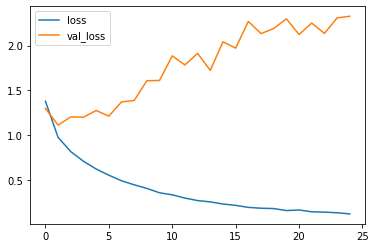

In [ ]:
import matplotlib.pyplot as plt
plt.plot(clf.history['loss'], label='loss')
plt.plot(clf.history['val_loss'], label='val_loss')
plt.legend()

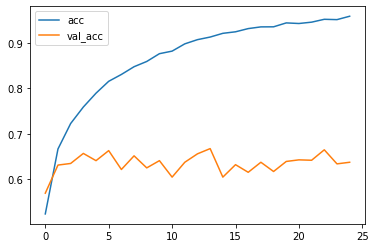

In [ ]:
plt.plot(clf.history['accuracy'], label='acc')
plt.plot(clf.history['val_accuracy'], label='val_acc')
plt.legend()

In [ ]:
hist = classifier.load_weights("/content/gdrive/My Drive/birdcnn.h5")

In [ ]:
test_datagen = ImageDataGenerator(rescale = 1./255)

In [ ]:
val_set = test_datagen.flow_from_directory('/content/gdrive/My Drive/10class/test',
                                            target_size = (64, 64),
                                            batch_size = 32,
                                            class_mode = 'categorical')

Found 2254 images belonging to 10 classes.


In [ ]:
his1 = classifier.evaluate(val_set)

71/71 [==============================] - 14s 197ms/step - loss: 1.6395 - accuracy: 0.7138


In [ ]:
import matplotlib.pyplot as plt

In [ ]:
birdlabel = {0: "Coccothraustescoccothraustes", 1: "Delichonurbicum", 2: "Phoenicurusochruros", 3: "Passermontanus",4:"Phoenicurusphoenicurus",5:"Parusmajor437591_1",6:"Garrulusglandarius",7:"Picapica",8:"Cardueliscarduelis",9:"Passerdomesticus"}

In [ ]:
birdlabel[1]

'Delichonurbicum'

In [ ]:
def saveMel1(signal, directory):
    
    # MK_spectrogram modified
    N_FFT = 1024         # 
    HOP_SIZE = 1024      #  
    N_MELS = 128          # Higher   
    WIN_SIZE = 1024      # 
    WINDOW_TYPE = 'hann' # 
    FEATURE = 'mel'      # 
    FMIN = 1400
    signal, sr = librosa.load(signal)

    fig = plt.figure(1,frameon=False)
    fig.set_size_inches(6,6)

    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    fig.add_axes(ax)
    
    S = librosa.feature.melspectrogram(y=signal, sr=sr,
                                        n_fft=N_FFT,
                                        hop_length=HOP_SIZE, 
                                        n_mels=N_MELS, 
                                        htk=True, 
                                        fmin=FMIN, # higher limit ##high-pass filter freq.
                                        fmax=sr/2) # AMPLITUDE
    librosa.display.specshow(librosa.power_to_db(S**2,ref=np.max), fmin=FMIN) #power = S**2

    fig.savefig(directory)
    plt.ioff()
    plt.show(block=False)
    fig.clf()
    ax.cla()
    plt.clf()
    plt.close('all')

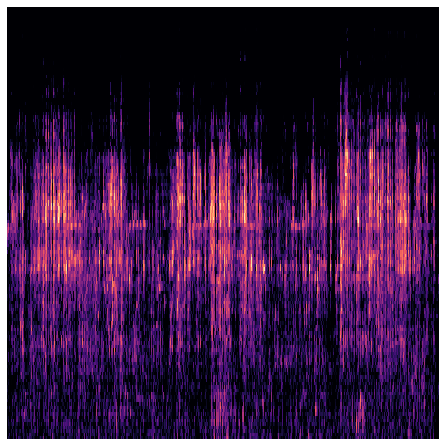

[9]
Passerdomesticus


In [ ]:
import cv2
import numpy as np
import gc
import librosa
import librosa.display
audio = '/content/gdrive/My Drive/1.mp3'
path = '/content/gdrive/My Drive/10class/pred/1.png'
path1 = '/content/gdrive/My Drive/10class/pred'
saveMel1(audio,path)
tes = cv2.imread(path)
tes = cv2.resize(tes,(64,64),interpolation=cv2.INTER_LINEAR)
tes = tes/255.0
tes = tes.reshape(1,tes.shape[0],tes.shape[1],tes.shape[2])
y = classifier.predict(tes)
label = np.argmax(y, axis=-1)
print(label)
print(birdlabel[label[0]])